In [ ]:
import pandas as pd
from scipy.io import arff
from sklearn.model_selection import train_test_split
import numpy as np
from sklearn.preprocessing import StandardScaler, LabelEncoder
import torch
import torch.nn as nn
import torch.optim as optim
from tqdm import tqdm
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
from sklearn.model_selection import KFold
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import StratifiedKFold

In [ ]:
file_path = "/content/adult.arff"
try:
    data, meta = arff.loadarff(file_path)
    df = pd.DataFrame(data)
except Exception as e:
    print(f"error loading the file: {e}")

### pre-processing

In [ ]:
for col in df.select_dtypes([object]):  # some cols were bytes so convert to str
    if isinstance(df[col].iloc[0], bytes):
        df[col] = df[col].str.decode('utf-8')

In [ ]:
df.head(3)

,age,workclass,fnlwgt,education,education-num,marital-status,occupation,relationship,race,sex,capital-gain,capital-loss,hours-per-week,native-country,income
0,39.0,State-gov,77516.0,Bachelors,13.0,Never-married,Adm-clerical,Not-in-family,White,Male,2174.0,0.0,40.0,United-States,<=50K
1,50.0,Self-emp-not-inc,83311.0,Bachelors,13.0,Married-civ-spouse,Exec-managerial,Husband,White,Male,0.0,0.0,13.0,United-States,<=50K
2,38.0,Private,215646.0,HS-grad,9.0,Divorced,Handlers-cleaners,Not-in-family,White,Male,0.0,0.0,40.0,United-States,<=50K


In [ ]:
missing_values = df.isnull().sum()
print(missing_values)

age               0
workclass         0
fnlwgt            0
education         0
education-num     0
marital-status    0
occupation        0
relationship      0
race              0
sex               0
capital-gain      0
capital-loss      0
hours-per-week    0
native-country    0
income            0
dtype: int64


In [ ]:
# Separate features and target
X = df.drop('income', axis=1)
y = df['income'].map({"<=50K": 0, ">50K": 1})

In [ ]:
X.describe()

,age,fnlwgt,education-num,capital-gain,capital-loss,hours-per-week
count,32561.000000,3.256100e+04,32561.000000,32561.000000,32561.000000,32561.000000
mean,38.581647,1.897784e+05,10.080679,1077.648844,87.303830,40.437456
std,13.640433,1.055500e+05,2.572720,7385.292085,402.960219,12.347429
min,17.000000,1.228500e+04,1.000000,0.000000,0.000000,1.000000
25%,28.000000,1.178270e+05,9.000000,0.000000,0.000000,40.000000
50%,37.000000,1.783560e+05,10.000000,0.000000,0.000000,40.000000
75%,48.000000,2.370510e+05,12.000000,0.000000,0.000000,45.000000
max,90.000000,1.484705e+06,16.000000,99999.000000,4356.000000,99.000000


In [ ]:
# Define seeds for reproducibility
seeds = [42, 22, 126]
splits = []

for seed in seeds:
    # Split into train-test
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=0.2, random_state=seed, stratify=y
    )

    # Create DataFrames for train and test data
    train_df = pd.DataFrame(X_train, columns=X.columns)
    test_df = pd.DataFrame(X_test, columns=X.columns)

    # Normalize 'education-num' (Ordinal Scaling)
    max_education = train_df['education-num'].max()
    train_df['education-num'] = (train_df['education-num'] - 1) / (max_education - 1)
    test_df['education-num'] = (test_df['education-num'] - 1) / (max_education - 1)

    # Standard Scaling for numerical columns: 'age', 'fnlwgt', 'hours-per-week'
    scaler = StandardScaler()
    for col in ['age', 'fnlwgt', 'hours-per-week']:
        train_df[col] = scaler.fit_transform(train_df[[col]])
        test_df[col] = scaler.transform(test_df[[col]])

    # Log Transformation + Standard Scaling for 'capital-gain' and 'capital-loss'
    for col in ['capital-gain', 'capital-loss']:
        train_df[col] = np.log1p(train_df[col])
        test_df[col] = np.log1p(test_df[col])

        train_df[col] = scaler.fit_transform(train_df[[col]])
        test_df[col] = scaler.transform(test_df[[col]])

    # One-Hot Encoding for categorical columns
    categorical_columns = [
        'workclass', 'education', 'marital-status', 'occupation',
        'relationship', 'race', 'sex', 'native-country'
    ]
    train_df = pd.get_dummies(train_df, columns=categorical_columns, drop_first=True)
    test_df = pd.get_dummies(test_df, columns=categorical_columns, drop_first=True)

    # Align test DataFrame columns with train DataFrame (fill missing columns with 0)
    test_df = test_df.reindex(columns=train_df.columns, fill_value=0)

    # Add the train-test split to the list of splits
    splits.append((train_df, test_df, y_train, y_test))


In [ ]:
splits[0][0].head() # train_df first seed


,age,fnlwgt,education-num,capital-gain,capital-loss,hours-per-week,workclass_Federal-gov,workclass_Local-gov,workclass_Never-worked,workclass_Private,...,native-country_Portugal,native-country_Puerto-Rico,native-country_Scotland,native-country_South,native-country_Taiwan,native-country_Thailand,native-country_Trinadad&Tobago,native-country_United-States,native-country_Vietnam,native-country_Yugoslavia
15738,-0.483065,-1.448150,0.800000,-0.297752,-0.221835,0.363947,False,False,False,True,...,False,False,False,False,False,False,False,True,False,False
27985,0.323342,-0.834549,0.866667,-0.297752,-0.221835,0.363947,False,False,False,True,...,False,False,False,False,False,False,False,True,False,False
30673,-1.362782,-0.642204,0.533333,-0.297752,-0.221835,-1.005102,False,False,False,False,...,False,False,False,False,False,False,False,True,False,False
9505,0.103413,-1.566121,0.600000,3.316154,-0.221835,-0.038714,False,True,False,False,...,False,False,False,False,False,False,False,True,False,False
26417,-1.069543,-0.720946,0.800000,-0.297752,-0.221835,-0.038714,False,False,False,True,...,False,False,False,False,False,False,False,True,False,False


In [ ]:
for i, (train_df, test_df, y_train, y_test) in enumerate(splits):
    print(f"Split {i+1}:")

    # Check if 'income' exists in train_df and test_df
    if 'income' in train_df.columns:
        print(f"  Train set 'income' unique values: {train_df['income'].unique()}")
    else:
        print("  Train set does not contain 'income' column.")

    if 'income' in test_df.columns:
        print(f"  Test set 'income' unique values: {test_df['income'].unique()}")
    else:
        print("  Test set does not contain 'income' column.")

    # Check target y_train and y_test
    print(f"  y_train unique values: {y_train.unique()}")
    print(f"  y_test unique values: {y_test.unique()}")
    print()


Split 1:
  Train set does not contain 'income' column.
  Test set does not contain 'income' column.
  y_train unique values: [1 0]
  y_test unique values: [0 1]

Split 2:
  Train set does not contain 'income' column.
  Test set does not contain 'income' column.
  y_train unique values: [0 1]
  y_test unique values: [0 1]

Split 3:
  Train set does not contain 'income' column.
  Test set does not contain 'income' column.
  y_train unique values: [0 1]
  y_test unique values: [1 0]



In [ ]:
# Display information about the splits
for i, (X_train, X_test, y_train, y_test) in enumerate(splits):
    print(f"Split num. {i+1}:")
    print(f"Train set size: {X_train.shape[0]}, Test set size: {X_test.shape[0]}")
    print(f"Train label distribution: {y_train.value_counts(normalize=True).to_dict()}")
    print(f"Test label distribution: {y_test.value_counts(normalize=True).to_dict()}")
    print()

Split num. 1:
Train set size: 26048, Test set size: 6513
Train label distribution: {0: 0.7591753685503686, 1: 0.24082463144963145}
Test label distribution: {0: 0.7592507293106096, 1: 0.24074927068939045}

Split num. 2:
Train set size: 26048, Test set size: 6513
Train label distribution: {0: 0.7591753685503686, 1: 0.24082463144963145}
Test label distribution: {0: 0.7592507293106096, 1: 0.24074927068939045}

Split num. 3:
Train set size: 26048, Test set size: 6513
Train label distribution: {0: 0.7591753685503686, 1: 0.24082463144963145}
Test label distribution: {0: 0.7592507293106096, 1: 0.24074927068939045}



### GAN Architecture

Generator:

מקבל רעש אקראי
z
 ומייצר נתונים סינתטיים שמתאימים למבנה הנתונים המקוריים (טבלאי ומנורמל).


Discriminator:

מקבל נתונים אמיתיים וסינתטיים ומסווג אותם כ"אמיתיים" (1) או "סינתטיים" (0).

הכפלה של מס' ה hidden units אצל הגנרטור גרמה לצמצום פערי הלמידה בלולאה האימון

In [ ]:
class Generator(nn.Module):
    def __init__(self, z_dim, output_dim, hidden_dim=128):
        super(Generator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(z_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim * 2),
            nn.ReLU(),
            nn.Linear(hidden_dim * 2, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, output_dim),
            nn.Tanh()
        )

    def forward(self, z):
        return self.model(z)


the dropout version make it harder for the dis. to learn

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, input_dim, hidden_dim=128):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(input_dim, hidden_dim),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3),  # Add dropout
            nn.Linear(hidden_dim, hidden_dim),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3),
            nn.Linear(hidden_dim, 1),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.model(x)


In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [ ]:
# parameters
z_dim = 100  # noise
data_dim = splits[0][0].shape[1]  # num of features in Train Data
hidden_dim = 128  # num of neurons in the hidden layers

# create the den and the dis
generator = Generator(z_dim, data_dim, hidden_dim).to(device)
discriminator = Discriminator(data_dim, hidden_dim).to(device)

loss_function = nn.BCELoss()  # Binary Cross-Entropy

lr = 0.0002
optimizer_g = optim.Adam(generator.parameters(), lr=lr)
optimizer_d = optim.Adam(discriminator.parameters(), lr=lr)

In [ ]:
num_epochs = 7000
batch_size = 64

# using only first pair of the train-test
train_df, test_df, y_train, y_test = splits[0]

In [ ]:
train_df = train_df.astype(float)


In [ ]:
sample_data = train_df.sample(batch_size).to_numpy()
print(f"Sample shape: {sample_data.shape}")
print(f"Sample min: {np.min(sample_data)}, max: {np.max(sample_data)}")
print(f"Contains NaN: {np.isnan(sample_data).sum()}")
print(f"Contains Inf: {np.isinf(sample_data).sum()}")


Sample shape: (64, 100)
Sample min: -2.9378776390100976, max: 5.273803390126163
Contains NaN: 0
Contains Inf: 0


In [ ]:
test_df = test_df.astype(float)

### Standard GAN

In [ ]:
# Define parameters
num_epochs = 7000
batch_size = 64
z_dim = 100  # noise dimension
hidden_dim = 128  # number of neurons in the hidden layers
lr = 0.0002  # learning rate

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# List to store the trained models
trained_models = []

In [ ]:
# Iterate through each train-test split
for split_idx, (train_df, test_df, y_train, y_test) in enumerate(splits):
    print(f"Starting training for split {split_idx + 1}...")

    # Define dimensions
    # data_dim = train_df.shape[1]  # number of features in train data
    data_dim = splits[0][0].shape[1]  # num of features in Train Data

    # Create the generator and discriminator
    generator = Generator(z_dim, data_dim, hidden_dim).to(device)
    discriminator = Discriminator(data_dim, hidden_dim).to(device)

    # Define loss function and optimizers
    loss_function = nn.BCELoss()  # Binary Cross-Entropy
    optimizer_g = optim.Adam(generator.parameters(), lr=lr)
    optimizer_d = optim.Adam(discriminator.parameters(), lr=lr)

    # Ensure train data is of type float
    train_df = train_df.astype(float)

    # Training loop
    for epoch in tqdm(range(num_epochs), desc=f"Training Progress (Split {split_idx + 1})"):
        # -------------------------
        # Train the discriminator
        # -------------------------
        real_data = torch.tensor(train_df.sample(batch_size).to_numpy(), dtype=torch.float32).to(device)
        z = torch.randn(batch_size, z_dim).to(device)  # random noise
        fake_data = generator(z).detach()  # synthetic data

        real_labels = torch.ones(batch_size, 1).to(device)  # real labels
        fake_labels = torch.zeros(batch_size, 1).to(device)  # fake labels

        optimizer_d.zero_grad()
        real_loss = loss_function(discriminator(real_data), real_labels)  # loss over real data
        fake_loss = loss_function(discriminator(fake_data), fake_labels)  # loss over fake data
        d_loss = real_loss + fake_loss  # total loss of the discriminator
        d_loss.backward()
        optimizer_d.step()

        # -------------------------
        # Train the generator
        # -------------------------
        z = torch.randn(batch_size, z_dim).to(device)  # random noise
        fake_data = generator(z)
        optimizer_g.zero_grad()

        # Modified generator loss: maximize log(D(G(z)))
        g_loss = -torch.mean(torch.log(discriminator(fake_data)))
        g_loss.backward()
        optimizer_g.step()

        # Print training status
        if epoch % 500 == 0:
            print(f"Epoch [{epoch}/{num_epochs}] | D Loss: {d_loss.item():.4f} | G Loss: {g_loss.item():.4f}")

    # Save the trained generator and discriminator for this split
    trained_models.append({"generator": generator, "discriminator": discriminator, "test_df": test_df})
    print(f"Training for split {split_idx + 1} completed.\n\n")

print("Training complete for all splits.")

Starting training for split 1...


Training Progress (Split 1):   0%|          | 9/7000 [00:00<03:31, 32.99it/s]

Epoch [0/7000] | D Loss: 1.3911 | G Loss: 0.6950


Training Progress (Split 1):   7%|▋         | 519/7000 [00:06<01:02, 104.24it/s]

Epoch [500/7000] | D Loss: 1.4124 | G Loss: 0.6765


Training Progress (Split 1):  14%|█▍        | 1013/7000 [00:11<01:00, 99.43it/s]

Epoch [1000/7000] | D Loss: 1.3164 | G Loss: 0.9012


Training Progress (Split 1):  22%|██▏       | 1514/7000 [00:16<01:17, 70.44it/s]

Epoch [1500/7000] | D Loss: 1.1464 | G Loss: 0.8685


Training Progress (Split 1):  29%|██▉       | 2020/7000 [00:22<00:50, 98.53it/s]

Epoch [2000/7000] | D Loss: 1.1659 | G Loss: 0.8287


Training Progress (Split 1):  36%|███▌      | 2512/7000 [00:27<00:45, 98.97it/s] 

Epoch [2500/7000] | D Loss: 1.0442 | G Loss: 1.1942


Training Progress (Split 1):  43%|████▎     | 3017/7000 [00:33<00:40, 98.85it/s]

Epoch [3000/7000] | D Loss: 1.6091 | G Loss: 0.9915


Training Progress (Split 1):  50%|█████     | 3519/7000 [00:38<00:33, 105.01it/s]

Epoch [3500/7000] | D Loss: 0.9632 | G Loss: 1.3124


Training Progress (Split 1):  57%|█████▋    | 4012/7000 [00:43<00:39, 74.75it/s]

Epoch [4000/7000] | D Loss: 1.4911 | G Loss: 0.8323


Training Progress (Split 1):  65%|██████▍   | 4520/7000 [00:49<00:25, 95.78it/s]

Epoch [4500/7000] | D Loss: 1.2463 | G Loss: 1.1381


Training Progress (Split 1):  72%|███████▏  | 5022/7000 [00:54<00:19, 100.71it/s]

Epoch [5000/7000] | D Loss: 1.3480 | G Loss: 0.7771


Training Progress (Split 1):  79%|███████▉  | 5517/7000 [01:00<00:15, 96.26it/s]

Epoch [5500/7000] | D Loss: 1.1107 | G Loss: 0.9151


Training Progress (Split 1):  86%|████████▌ | 6016/7000 [01:06<00:11, 84.89it/s]

Epoch [6000/7000] | D Loss: 1.1626 | G Loss: 1.0764


Training Progress (Split 1):  93%|█████████▎| 6509/7000 [01:12<00:06, 71.86it/s]

Epoch [6500/7000] | D Loss: 1.4955 | G Loss: 1.0849


Training Progress (Split 1): 100%|██████████| 7000/7000 [01:17<00:00, 89.80it/s] 


Training for split 1 completed.


Starting training for split 2...


Training Progress (Split 2):   0%|          | 11/7000 [00:00<01:05, 107.01it/s]

Epoch [0/7000] | D Loss: 1.3806 | G Loss: 0.6712


Training Progress (Split 2):   7%|▋         | 515/7000 [00:05<01:04, 101.14it/s]

Epoch [500/7000] | D Loss: 1.4667 | G Loss: 0.6435


Training Progress (Split 2):  14%|█▍        | 1012/7000 [00:11<01:05, 91.88it/s]

Epoch [1000/7000] | D Loss: 1.5450 | G Loss: 0.6504


Training Progress (Split 2):  22%|██▏       | 1517/7000 [00:16<00:54, 100.58it/s]

Epoch [1500/7000] | D Loss: 1.2227 | G Loss: 0.8199


Training Progress (Split 2):  29%|██▊       | 2009/7000 [00:21<01:10, 70.50it/s]

Epoch [2000/7000] | D Loss: 1.2406 | G Loss: 1.2211


Training Progress (Split 2):  36%|███▌      | 2517/7000 [00:27<00:46, 95.61it/s]

Epoch [2500/7000] | D Loss: 1.4297 | G Loss: 1.3381


Training Progress (Split 2):  43%|████▎     | 3012/7000 [00:32<00:39, 101.25it/s]

Epoch [3000/7000] | D Loss: 0.9494 | G Loss: 1.2156


Training Progress (Split 2):  50%|█████     | 3512/7000 [00:39<00:35, 97.74it/s]

Epoch [3500/7000] | D Loss: 1.2749 | G Loss: 0.9429


Training Progress (Split 2):  57%|█████▋    | 4014/7000 [00:44<00:29, 101.83it/s]

Epoch [4000/7000] | D Loss: 1.4674 | G Loss: 0.6613


Training Progress (Split 2):  64%|██████▍   | 4508/7000 [00:49<00:37, 67.17it/s]

Epoch [4500/7000] | D Loss: 1.0483 | G Loss: 1.0771


Training Progress (Split 2):  72%|███████▏  | 5017/7000 [00:55<00:20, 98.62it/s]

Epoch [5000/7000] | D Loss: 1.4022 | G Loss: 1.4248


Training Progress (Split 2):  79%|███████▉  | 5514/7000 [01:00<00:14, 101.63it/s]

Epoch [5500/7000] | D Loss: 1.2057 | G Loss: 0.9013


Training Progress (Split 2):  86%|████████▌ | 6017/7000 [01:06<00:09, 98.91it/s]

Epoch [6000/7000] | D Loss: 1.0515 | G Loss: 1.1967


Training Progress (Split 2):  93%|█████████▎| 6520/7000 [01:11<00:04, 101.67it/s]

Epoch [6500/7000] | D Loss: 1.1862 | G Loss: 0.9747


Training Progress (Split 2): 100%|██████████| 7000/7000 [01:17<00:00, 90.37it/s]


Training for split 2 completed.


Starting training for split 3...


Training Progress (Split 3):   0%|          | 7/7000 [00:00<01:41, 69.00it/s]

Epoch [0/7000] | D Loss: 1.3881 | G Loss: 0.6800


Training Progress (Split 3):   7%|▋         | 517/7000 [00:05<01:05, 98.35it/s] 

Epoch [500/7000] | D Loss: 1.3897 | G Loss: 0.6571


Training Progress (Split 3):  14%|█▍        | 1012/7000 [00:10<00:58, 101.62it/s]

Epoch [1000/7000] | D Loss: 1.2902 | G Loss: 0.7754


Training Progress (Split 3):  22%|██▏       | 1516/7000 [00:16<00:58, 93.45it/s]

Epoch [1500/7000] | D Loss: 1.2613 | G Loss: 0.8679


Training Progress (Split 3):  29%|██▊       | 2009/7000 [00:21<00:51, 96.89it/s] 

Epoch [2000/7000] | D Loss: 1.2053 | G Loss: 0.7452


Training Progress (Split 3):  36%|███▌      | 2516/7000 [00:27<01:00, 73.68it/s]

Epoch [2500/7000] | D Loss: 1.1250 | G Loss: 1.1327


Training Progress (Split 3):  43%|████▎     | 3020/7000 [00:33<00:41, 96.88it/s]

Epoch [3000/7000] | D Loss: 1.1020 | G Loss: 0.6911


Training Progress (Split 3):  50%|█████     | 3512/7000 [00:38<00:35, 97.12it/s]

Epoch [3500/7000] | D Loss: 1.0570 | G Loss: 1.2262


Training Progress (Split 3):  57%|█████▋    | 4015/7000 [00:44<00:41, 71.93it/s]

Epoch [4000/7000] | D Loss: 1.1664 | G Loss: 1.3554


Training Progress (Split 3):  65%|██████▍   | 4516/7000 [00:49<00:24, 103.46it/s]

Epoch [4500/7000] | D Loss: 1.1070 | G Loss: 1.4874


Training Progress (Split 3):  72%|███████▏  | 5012/7000 [00:54<00:28, 69.21it/s]

Epoch [5000/7000] | D Loss: 1.0620 | G Loss: 0.9361


Training Progress (Split 3):  79%|███████▉  | 5519/7000 [01:01<00:15, 97.28it/s]

Epoch [5500/7000] | D Loss: 1.0962 | G Loss: 0.9639


Training Progress (Split 3):  86%|████████▌ | 6015/7000 [01:07<00:10, 96.97it/s]

Epoch [6000/7000] | D Loss: 0.8408 | G Loss: 1.4687


Training Progress (Split 3):  93%|█████████▎| 6511/7000 [01:13<00:07, 65.03it/s]

Epoch [6500/7000] | D Loss: 1.3113 | G Loss: 1.0269


Training Progress (Split 3): 100%|██████████| 7000/7000 [01:18<00:00, 89.24it/s]

Training for split 3 completed.


Training complete for all splits.


b.	After training is complete, use your model to generate a synthetic dataset equal in size to your training set

In [ ]:
# Generate synthetic dataset
synthetic_datasets = []

for split_idx, model in enumerate(trained_models):
    print(f"Generating synthetic dataset for split {split_idx + 1}...")

    # Retrieve the generator and test_df
    generator = model["generator"]
    generator.eval()  # Set the generator to evaluation mode
    train_size = splits[split_idx][0].shape[0]  # Number of rows in training set
    data_dim = splits[split_idx][0].shape[1]  # Number of features

    # Generate noise for the entire dataset size
    z = torch.randn(train_size, z_dim).to(device)
    # z = torch.normal(mean=0, std=2, size=(train_size, z_dim)).to(device)


    # Generate synthetic data
    with torch.no_grad():  # No gradients needed for generation
        synthetic_data = generator(z).cpu().numpy()  # Move data to CPU and convert to numpy array

    # Create a DataFrame for the synthetic dataset
    synthetic_df = pd.DataFrame(synthetic_data, columns=splits[split_idx][0].columns)
    synthetic_datasets.append(synthetic_df)

    print(f"Synthetic dataset for split {split_idx + 1} generated successfully.\n")

print("All synthetic datasets generated.")


Generating synthetic dataset for split 1...
Synthetic dataset for split 1 generated successfully.

Generating synthetic dataset for split 2...
Synthetic dataset for split 2 generated successfully.

Generating synthetic dataset for split 3...
Synthetic dataset for split 3 generated successfully.

All synthetic datasets generated.


c.	Produce visualizations comparing real vs. synthetic feature distributions (e.g., histograms, correlation matrices).

In [ ]:
# Convert boolean columns to integers before plotting
train_df = train_df.astype({col: int for col in train_df.select_dtypes(include=['bool']).columns})
synthetic_df = synthetic_df.astype({col: int for col in synthetic_df.select_dtypes(include=['bool']).columns})


Visualizing feature distributions for split 1...


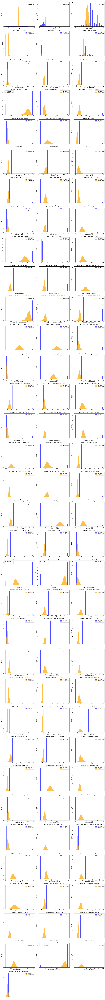

Visualizing feature distributions for split 2...


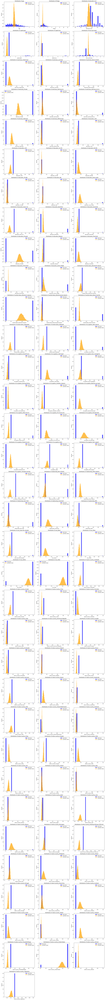

Visualizing feature distributions for split 3...


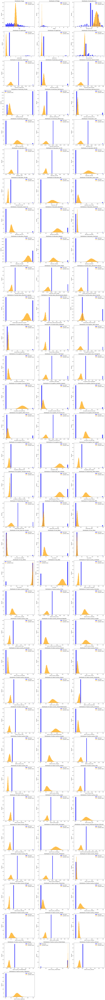

In [ ]:
for split_idx, (train_df, synthetic_df) in enumerate(zip([s[0] for s in splits], synthetic_datasets)):
    print(f"Visualizing feature distributions for split {split_idx + 1}...")

    # Convert boolean columns to integers
    train_df = train_df.astype({col: int for col in train_df.select_dtypes(include=['bool']).columns})
    synthetic_df = synthetic_df.astype({col: int for col in synthetic_df.select_dtypes(include=['bool']).columns})

    # Combine numerical and categorical columns
    all_columns = train_df.columns

    # Define Subplots
    n_cols = 3  # Number of columns in the grid
    n_rows = int(np.ceil(len(all_columns) / n_cols))  # Number of rows needed
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 5 * n_rows))
    axes = axes.flatten()  # Flatten the axes array for easy indexing

    for i, col in enumerate(all_columns):
        ax = axes[i]
        ax.hist(train_df[col], bins=30, alpha=0.7, label='Real Data', color='blue', density=True)
        ax.hist(synthetic_df[col], bins=30, alpha=0.7, label='Synthetic Data', color='orange', density=True)
        ax.set_title(f'Distribution of {col}')
        ax.set_xlabel(col)
        ax.set_ylabel('Density')
        ax.legend()

    # Hide unused subplots
    for j in range(len(all_columns), len(axes)):
        axes[j].set_visible(False)

    plt.tight_layout()
    plt.show()


Visualizing box plots for split 1...


<ipython-input-25-47b56769b134>:19: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-25-47b56769b134>:19: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-25-47b56769b134>:19: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-25-47b56769b134>:19: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-25-47b56769b134>:19: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick

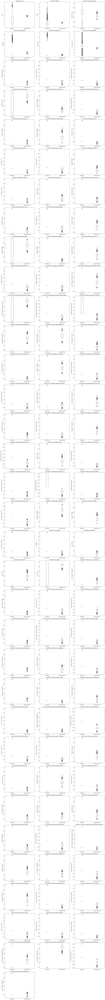

Visualizing box plots for split 2...


<ipython-input-25-47b56769b134>:19: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-25-47b56769b134>:19: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-25-47b56769b134>:19: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-25-47b56769b134>:19: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-25-47b56769b134>:19: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick

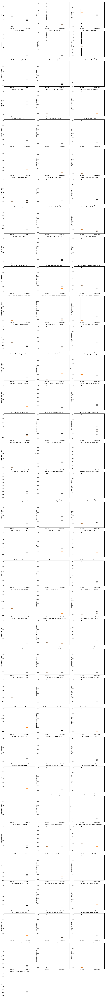

Visualizing box plots for split 3...


<ipython-input-25-47b56769b134>:19: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-25-47b56769b134>:19: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-25-47b56769b134>:19: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-25-47b56769b134>:19: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-25-47b56769b134>:19: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick

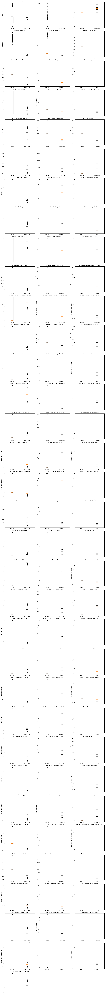

In [ ]:
for split_idx, (train_df, synthetic_df) in enumerate(zip([s[0] for s in splits], synthetic_datasets)):
    print(f"Visualizing box plots for split {split_idx + 1}...")

    # Convert boolean columns to integers
    train_df = train_df.astype({col: int for col in train_df.select_dtypes(include=['bool']).columns})
    synthetic_df = synthetic_df.astype({col: int for col in synthetic_df.select_dtypes(include=['bool']).columns})

    # Combine numerical and categorical columns
    all_columns = train_df.columns

    # Define Subplots
    n_cols = 3  # Number of columns in the grid
    n_rows = int(np.ceil(len(all_columns) / n_cols))  # Number of rows needed
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 5 * n_rows))
    axes = axes.flatten()  # Flatten the axes array for easy indexing

    for i, col in enumerate(all_columns):
        ax = axes[i]
        ax.boxplot(
            [train_df[col].dropna(), synthetic_df[col].dropna()],
            labels=['Real Data', 'Synthetic Data']
        )
        ax.set_title(f'Box Plot of {col}')
        ax.set_ylabel(col)

    # Hide unused subplots
    for j in range(len(all_columns), len(axes)):
        axes[j].set_visible(False)

    plt.tight_layout()
    plt.show()


d. Detection

In [ ]:
overall_auc_scores = []

for split_idx, (train_df, synthetic_df) in enumerate(zip([s[0] for s in splits], synthetic_datasets)):
    print(f"Processing Split {split_idx + 1}...")

    # Label the real and synthetic data
    real_data = train_df.copy()
    real_data['label'] = 0  # Real data labeled as 0
    synthetic_data = synthetic_df.copy()
    synthetic_data['label'] = 1  # Synthetic data labeled as 1

    # Combine real and synthetic data
    combined_data = pd.concat([real_data, synthetic_data], ignore_index=True)
    X = combined_data.drop(columns=['label'])
    y = combined_data['label']

    # Define Stratified K-Fold
    skf = StratifiedKFold(n_splits=4, shuffle=True, random_state=42)
    auc_scores = []

    # Perform 4-fold evaluation
    fold_splits = list(skf.split(X, y))
    for i in range(4):
        # Define train and test folds
        test_indices = fold_splits[i][1]
        train_indices = np.concatenate([fold_splits[j][1] for j in range(4) if j != i])

        # Split data into training and testing sets
        X_train, X_test = X.iloc[train_indices], X.iloc[test_indices]
        y_train, y_test = y.iloc[train_indices], y.iloc[test_indices]

        # Train Random Forest
        rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
        rf_model.fit(X_train, y_train)

        # Predict probabilities for the test set
        y_pred_prob = rf_model.predict_proba(X_test)[:, 1]

        # Calculate AUC
        auc = roc_auc_score(y_test, y_pred_prob)
        auc_scores.append(auc)

    # Report the average AUC for this split
    split_avg_auc = np.mean(auc_scores)
    overall_auc_scores.append(split_avg_auc)
    print(f"Average AUC for Split {split_idx + 1}: {split_avg_auc:.4f}")

# Report overall results
overall_avg_auc = np.mean(overall_auc_scores)
print(f"\nOverall Average AUC across all splits: {overall_avg_auc:.4f}")

Processing Split 1...
Average AUC for Split 1: 1.0000
Processing Split 2...
Average AUC for Split 2: 1.0000
Processing Split 3...
Average AUC for Split 3: 1.0000

Overall Average AUC across all splits: 1.0000


In [ ]:
real_stats = train_df.describe().transpose()
synthetic_stats = synthetic_df.describe().transpose()

# Combine the two statistics
stats_comparison = real_stats[['mean', 'std']].join(synthetic_stats[['mean', 'std']], lsuffix='_real', rsuffix='_synthetic')
print(stats_comparison)


                   mean_real  std_real  mean_synthetic  std_synthetic
age            -2.809655e-17  1.000019        0.386517       0.129664
fnlwgt         -1.216608e-16  1.000019       -0.930415       0.043792
education-num   6.058200e-01  0.170840        0.767378       0.062064
capital-gain   -4.050814e-17  1.000019       -0.835098       0.068494
capital-loss   -3.955340e-18  1.000019       -0.549543       0.063555
hours-per-week -1.227519e-17  1.000019       -0.524328       0.109529


f. efficacy

In [ ]:
efficacy_scores = []

for split_idx, (split, synthetic_df) in enumerate(zip(splits, synthetic_datasets)):
    train_df, test_df, y_train, y_test = split
    print(f"Processing Split {split_idx + 1} for efficacy...")

    # task (i)
    rf_real = RandomForestClassifier(n_estimators=100, random_state=42)
    rf_real.fit(train_df, y_train)
    y_pred_prob_real = rf_real.predict_proba(test_df)[:, 1]
    auc_real = roc_auc_score(y_test, y_pred_prob_real)

    # task (ii)
    rf_synthetic = RandomForestClassifier(n_estimators=100, random_state=42)
    rf_synthetic.fit(synthetic_df, y_train)
    y_pred_prob_synthetic = rf_synthetic.predict_proba(test_df)[:, 1]
    auc_synthetic = roc_auc_score(y_test, y_pred_prob_synthetic)

    # task (iii)
    efficacy_score = auc_synthetic / auc_real if auc_real > 0 else 0
    efficacy_scores.append(efficacy_score)

    print(f"Split {split_idx + 1}:")
    print(f"  AUC (Real Data)     : {auc_real:.4f}")
    print(f"  AUC (Synthetic Data): {auc_synthetic:.4f}")
    print(f"  Efficacy Score      : {efficacy_score:.4f}")

overall_efficacy = np.mean(efficacy_scores)
print(f"\nOverall Average Efficacy Score across all splits: {overall_efficacy:.4f}")


Processing Split 1 for efficacy...
Split 1:
  AUC (Real Data)     : 0.9089
  AUC (Synthetic Data): 0.6303
  Efficacy Score      : 0.6935
Processing Split 2 for efficacy...
Split 2:
  AUC (Real Data)     : 0.9026
  AUC (Synthetic Data): 0.5909
  Efficacy Score      : 0.6547
Processing Split 3 for efficacy...
Split 3:
  AUC (Real Data)     : 0.9066
  AUC (Synthetic Data): 0.5656
  Efficacy Score      : 0.6238

Overall Average Efficacy Score across all splits: 0.6574


### forgiving teacher method

In [ ]:
num_discriminators = 3
split_losses = {}

for fold_idx, (train_df, test_df, y_train, y_test) in enumerate(splits):
    print(f"Training on Split {fold_idx + 1}/{len(splits)}")

    # create the 3 dis.
    discriminators = [Discriminator(data_dim, hidden_dim).to(device) for _ in range(num_discriminators)]
    optimizers_d = [optim.Adam(d.parameters(), lr=lr) for d in discriminators]

    generator = Generator(z_dim, data_dim, hidden_dim).to(device)
    optimizer_g = optim.Adam(generator.parameters(), lr=lr)

    train_df = train_df.astype(float)

    # save losses for each split
    generator_losses = []
    discriminator_losses = [[] for _ in range(num_discriminators)]

    for epoch in tqdm(range(num_epochs), desc=f"Training Progress - Split {fold_idx + 1}"):
        real_data = torch.tensor(train_df.sample(batch_size).to_numpy().astype(np.float32), dtype=torch.float32).to(device)
        z = torch.randn(batch_size, z_dim).to(device)
        fake_data = generator(z).detach()

        real_labels = torch.ones(batch_size, 1).to(device)
        fake_labels = torch.zeros(batch_size, 1).to(device)

        # update dis.
        d_losses = []
        for i, (disc, opt_d) in enumerate(zip(discriminators, optimizers_d)):
            opt_d.zero_grad()
            real_loss = loss_function(disc(real_data), real_labels)
            fake_loss = loss_function(disc(fake_data), fake_labels)
            d_loss = real_loss + fake_loss
            d_loss.backward()
            opt_d.step()
            d_losses.append(d_loss.item())
            discriminator_losses[i].append(d_loss.item())

        # update gen.
        z = torch.randn(batch_size, z_dim).to(device)
        fake_data = generator(z)
        optimizer_g.zero_grad()
        g_loss = -torch.mean(torch.stack([torch.log(disc(fake_data)) for disc in discriminators]))
        g_loss.backward()
        optimizer_g.step()

        generator_losses.append(g_loss.item())

        if epoch % 500 == 0:
            print(f"Epoch [{epoch}/{num_epochs}] (Split {fold_idx + 1})")
            print(f"  D Losses: {', '.join([f'D{i}: {loss:.4f}' for i, loss in enumerate(d_losses)])}")
            print(f"  G Loss: {g_loss.item():.4f}")

    # save losses
    split_losses[fold_idx] = {
        "generator": generator_losses,
        "discriminators": discriminator_losses
    }


Training on Split 1/3


Training Progress - Split 1:   0%|          | 6/7000 [00:00<02:13, 52.36it/s]

Epoch [0/7000] (Split 1)
  D Losses: D0: 1.3794, D1: 1.3872, D2: 1.3943
  G Loss: 0.6816


Training Progress - Split 1:   7%|▋         | 509/7000 [00:10<01:55, 56.27it/s]

Epoch [500/7000] (Split 1)
  D Losses: D0: 1.3595, D1: 1.3692, D2: 1.4155
  G Loss: 0.6813


Training Progress - Split 1:  14%|█▍        | 1008/7000 [00:19<02:18, 43.19it/s]

Epoch [1000/7000] (Split 1)
  D Losses: D0: 1.4194, D1: 1.1843, D2: 1.1973
  G Loss: 1.1297


Training Progress - Split 1:  22%|██▏       | 1512/7000 [00:30<01:42, 53.52it/s]

Epoch [1500/7000] (Split 1)
  D Losses: D0: 1.1909, D1: 0.8737, D2: 1.3287
  G Loss: 1.1700


Training Progress - Split 1:  29%|██▊       | 2008/7000 [00:40<01:31, 54.67it/s]

Epoch [2000/7000] (Split 1)
  D Losses: D0: 1.1204, D1: 1.2010, D2: 1.1013
  G Loss: 0.9683


Training Progress - Split 1:  36%|███▌      | 2507/7000 [00:50<02:03, 36.45it/s]

Epoch [2500/7000] (Split 1)
  D Losses: D0: 1.0845, D1: 0.8983, D2: 0.9813
  G Loss: 0.9419


Training Progress - Split 1:  43%|████▎     | 3011/7000 [01:00<01:14, 53.21it/s]

Epoch [3000/7000] (Split 1)
  D Losses: D0: 1.4990, D1: 2.0519, D2: 1.7182
  G Loss: 0.9724


Training Progress - Split 1:  50%|█████     | 3510/7000 [01:11<01:03, 55.06it/s]

Epoch [3500/7000] (Split 1)
  D Losses: D0: 1.5282, D1: 1.6642, D2: 1.4831
  G Loss: 0.7896


Training Progress - Split 1:  57%|█████▋    | 4008/7000 [01:21<00:57, 51.84it/s]

Epoch [4000/7000] (Split 1)
  D Losses: D0: 0.7823, D1: 1.0352, D2: 0.8478
  G Loss: 1.2659


Training Progress - Split 1:  64%|██████▍   | 4505/7000 [01:32<01:10, 35.52it/s]

Epoch [4500/7000] (Split 1)
  D Losses: D0: 1.1954, D1: 1.2516, D2: 1.3833
  G Loss: 0.9623


Training Progress - Split 1:  72%|███████▏  | 5012/7000 [01:43<00:35, 55.74it/s]

Epoch [5000/7000] (Split 1)
  D Losses: D0: 0.9399, D1: 1.2418, D2: 1.0058
  G Loss: 1.0769


Training Progress - Split 1:  79%|███████▊  | 5508/7000 [01:54<00:28, 52.75it/s]

Epoch [5500/7000] (Split 1)
  D Losses: D0: 1.0460, D1: 0.8444, D2: 0.8413
  G Loss: 1.1429


Training Progress - Split 1:  86%|████████▌ | 6006/7000 [02:04<00:27, 35.88it/s]

Epoch [6000/7000] (Split 1)
  D Losses: D0: 0.8379, D1: 0.8687, D2: 0.9770
  G Loss: 1.3068


Training Progress - Split 1:  93%|█████████▎| 6508/7000 [02:14<00:08, 55.08it/s]

Epoch [6500/7000] (Split 1)
  D Losses: D0: 1.0455, D1: 1.1297, D2: 1.2004
  G Loss: 1.6094


Training Progress - Split 1: 100%|██████████| 7000/7000 [02:24<00:00, 48.47it/s]


Training on Split 2/3


Training Progress - Split 2:   0%|          | 7/7000 [00:00<01:55, 60.60it/s]

Epoch [0/7000] (Split 2)
  D Losses: D0: 1.3962, D1: 1.3724, D2: 1.3687
  G Loss: 0.6775


Training Progress - Split 2:   7%|▋         | 508/7000 [00:10<01:54, 56.73it/s]

Epoch [500/7000] (Split 2)
  D Losses: D0: 1.4470, D1: 1.4901, D2: 1.3916
  G Loss: 0.6987


Training Progress - Split 2:  14%|█▍        | 1006/7000 [00:20<02:56, 33.96it/s]

Epoch [1000/7000] (Split 2)
  D Losses: D0: 1.1385, D1: 1.0884, D2: 1.0149
  G Loss: 0.9420


Training Progress - Split 2:  22%|██▏       | 1512/7000 [00:30<01:42, 53.35it/s]

Epoch [1500/7000] (Split 2)
  D Losses: D0: 1.3078, D1: 1.2038, D2: 1.1298
  G Loss: 0.7593


Training Progress - Split 2:  29%|██▊       | 2008/7000 [00:41<01:27, 56.76it/s]

Epoch [2000/7000] (Split 2)
  D Losses: D0: 1.3803, D1: 1.4199, D2: 1.4266
  G Loss: 0.9783


Training Progress - Split 2:  36%|███▌      | 2509/7000 [00:51<01:26, 52.20it/s]

Epoch [2500/7000] (Split 2)
  D Losses: D0: 1.1567, D1: 1.1945, D2: 1.4962
  G Loss: 0.7687


Training Progress - Split 2:  43%|████▎     | 3007/7000 [01:00<01:29, 44.60it/s]

Epoch [3000/7000] (Split 2)
  D Losses: D0: 1.1614, D1: 1.1535, D2: 1.0173
  G Loss: 1.3745


Training Progress - Split 2:  50%|█████     | 3510/7000 [01:11<01:07, 51.80it/s]

Epoch [3500/7000] (Split 2)
  D Losses: D0: 1.3021, D1: 1.1846, D2: 1.0804
  G Loss: 0.8937


Training Progress - Split 2:  57%|█████▋    | 4012/7000 [01:21<00:53, 56.28it/s]

Epoch [4000/7000] (Split 2)
  D Losses: D0: 0.7100, D1: 0.9797, D2: 1.0101
  G Loss: 1.1807


Training Progress - Split 2:  64%|██████▍   | 4508/7000 [01:32<01:05, 38.22it/s]

Epoch [4500/7000] (Split 2)
  D Losses: D0: 1.2005, D1: 1.0358, D2: 0.9269
  G Loss: 1.1901


Training Progress - Split 2:  72%|███████▏  | 5011/7000 [01:41<00:36, 54.39it/s]

Epoch [5000/7000] (Split 2)
  D Losses: D0: 1.1221, D1: 1.0865, D2: 0.9458
  G Loss: 1.1774


Training Progress - Split 2:  79%|███████▊  | 5506/7000 [01:52<00:28, 52.24it/s]

Epoch [5500/7000] (Split 2)
  D Losses: D0: 0.7842, D1: 0.7926, D2: 0.8239
  G Loss: 0.9768


Training Progress - Split 2:  86%|████████▌ | 6006/7000 [02:02<00:19, 51.73it/s]

Epoch [6000/7000] (Split 2)
  D Losses: D0: 0.6538, D1: 0.8550, D2: 1.0719
  G Loss: 1.8114


Training Progress - Split 2:  93%|█████████▎| 6508/7000 [02:13<00:14, 34.20it/s]

Epoch [6500/7000] (Split 2)
  D Losses: D0: 0.9949, D1: 1.0749, D2: 0.8866
  G Loss: 0.9134


Training Progress - Split 2: 100%|██████████| 7000/7000 [02:23<00:00, 48.87it/s]


Training on Split 3/3


Training Progress - Split 3:   0%|          | 6/7000 [00:00<02:11, 53.38it/s]

Epoch [0/7000] (Split 3)
  D Losses: D0: 1.3906, D1: 1.3856, D2: 1.3865
  G Loss: 0.7006


Training Progress - Split 3:   7%|▋         | 509/7000 [00:10<01:53, 57.00it/s]

Epoch [500/7000] (Split 3)
  D Losses: D0: 1.4107, D1: 1.4504, D2: 1.3191
  G Loss: 0.7309


Training Progress - Split 3:  14%|█▍        | 1007/7000 [00:21<01:50, 54.26it/s]

Epoch [1000/7000] (Split 3)
  D Losses: D0: 1.1606, D1: 1.1648, D2: 1.0901
  G Loss: 0.8045


Training Progress - Split 3:  22%|██▏       | 1508/7000 [00:31<02:26, 37.43it/s]

Epoch [1500/7000] (Split 3)
  D Losses: D0: 1.1597, D1: 1.0720, D2: 1.0618
  G Loss: 0.8409


Training Progress - Split 3:  29%|██▊       | 2011/7000 [00:41<01:34, 53.04it/s]

Epoch [2000/7000] (Split 3)
  D Losses: D0: 0.8983, D1: 1.0342, D2: 1.1691
  G Loss: 0.9456


Training Progress - Split 3:  36%|███▌      | 2509/7000 [00:51<01:29, 50.35it/s]

Epoch [2500/7000] (Split 3)
  D Losses: D0: 1.0135, D1: 1.0299, D2: 0.9051
  G Loss: 1.0668


Training Progress - Split 3:  43%|████▎     | 3012/7000 [01:02<01:13, 54.28it/s]

Epoch [3000/7000] (Split 3)
  D Losses: D0: 0.8492, D1: 0.7907, D2: 1.0471
  G Loss: 1.4163


Training Progress - Split 3:  50%|█████     | 3509/7000 [01:12<01:27, 40.10it/s]

Epoch [3500/7000] (Split 3)
  D Losses: D0: 0.9207, D1: 0.7863, D2: 1.0987
  G Loss: 1.4674


Training Progress - Split 3:  57%|█████▋    | 4009/7000 [01:22<00:54, 55.18it/s]

Epoch [4000/7000] (Split 3)
  D Losses: D0: 1.4995, D1: 1.3938, D2: 1.0431
  G Loss: 0.8890


Training Progress - Split 3:  64%|██████▍   | 4507/7000 [01:32<00:47, 52.12it/s]

Epoch [4500/7000] (Split 3)
  D Losses: D0: 0.9774, D1: 1.0530, D2: 1.2575
  G Loss: 1.5290


Training Progress - Split 3:  72%|███████▏  | 5005/7000 [01:44<00:41, 48.34it/s]

Epoch [5000/7000] (Split 3)
  D Losses: D0: 0.8740, D1: 0.9883, D2: 1.0667
  G Loss: 1.0829


Training Progress - Split 3:  79%|███████▊  | 5507/7000 [01:55<00:43, 34.39it/s]

Epoch [5500/7000] (Split 3)
  D Losses: D0: 0.8724, D1: 1.0006, D2: 0.9663
  G Loss: 1.1377


Training Progress - Split 3:  86%|████████▌ | 6011/7000 [02:05<00:19, 50.43it/s]

Epoch [6000/7000] (Split 3)
  D Losses: D0: 0.7926, D1: 0.8887, D2: 0.8915
  G Loss: 1.0584


Training Progress - Split 3:  93%|█████████▎| 6507/7000 [02:16<00:09, 51.43it/s]

Epoch [6500/7000] (Split 3)
  D Losses: D0: 1.3806, D1: 1.0833, D2: 1.0564
  G Loss: 1.3780


Training Progress - Split 3: 100%|██████████| 7000/7000 [02:26<00:00, 47.80it/s]


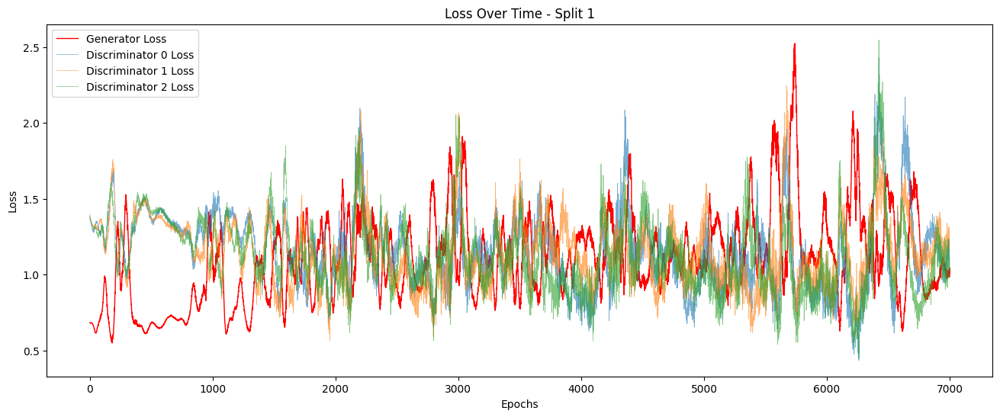

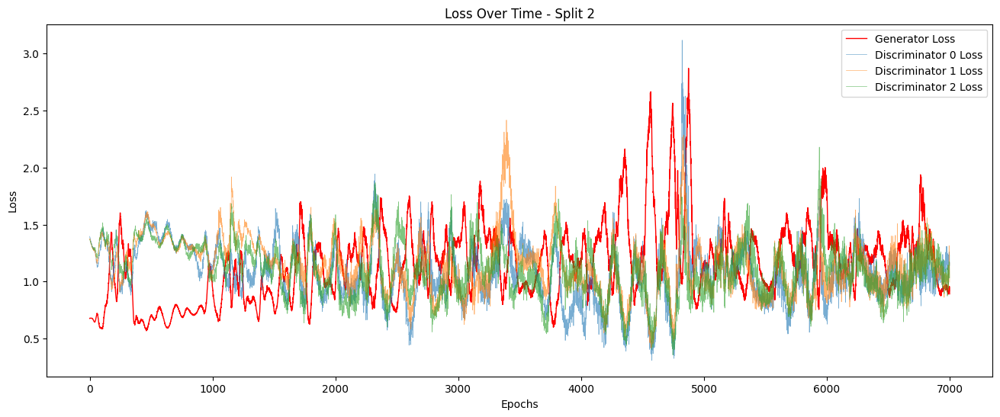

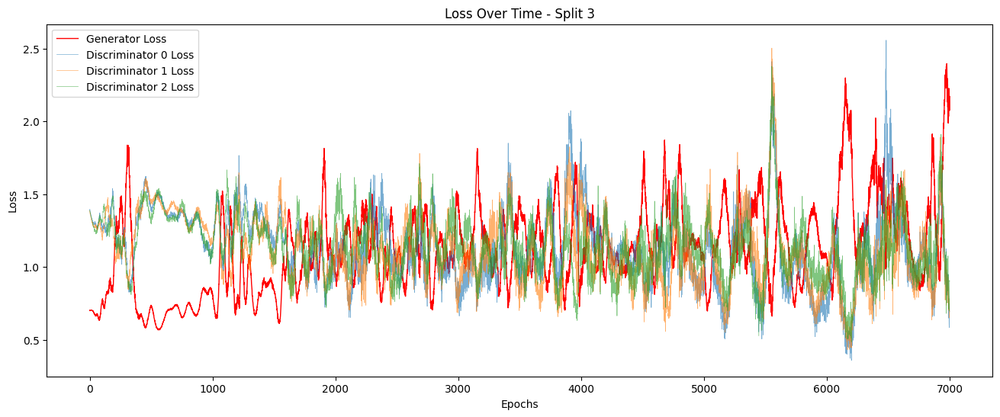

In [ ]:
for split_idx, losses in split_losses.items():
    plt.figure(figsize=(16, 6))

    # gen loss
    plt.plot(losses["generator"], label='Generator Loss', color='red', linewidth=1)

    # 3 dis losses
    for i, d_loss in enumerate(losses["discriminators"]):
        plt.plot(d_loss, label=f'Discriminator {i} Loss',linewidth=0.5, alpha=0.6)

    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title(f'Loss Over Time - Split {split_idx + 1}')
    plt.legend()
    plt.show()


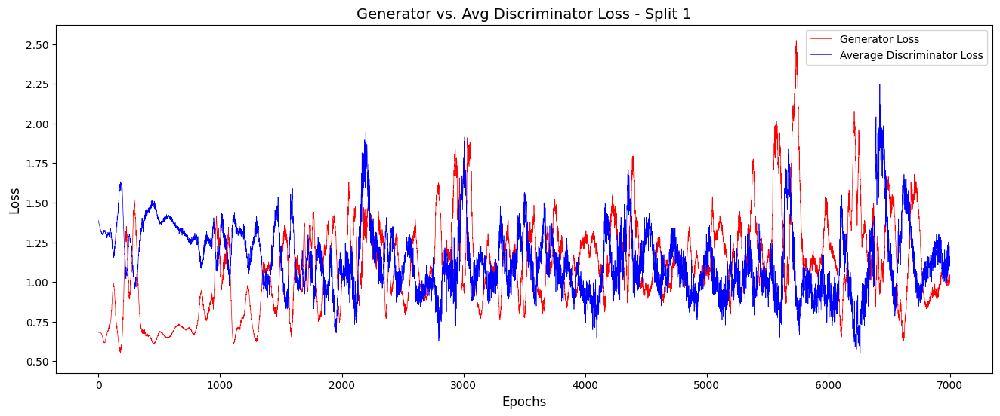

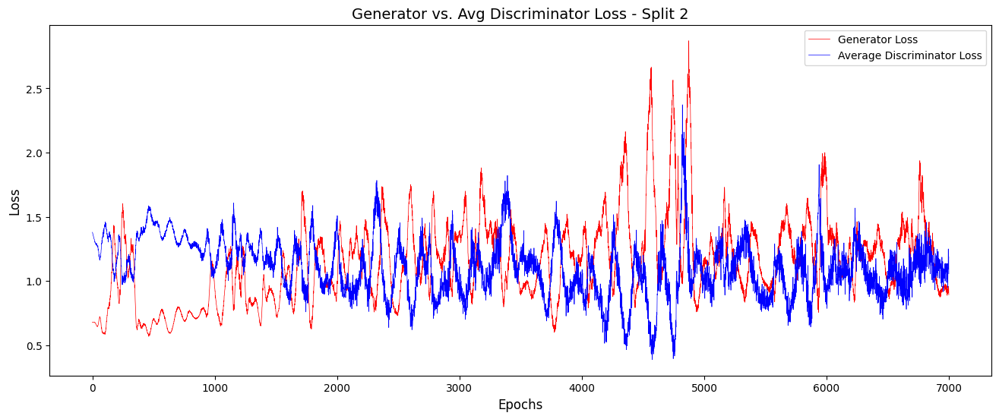

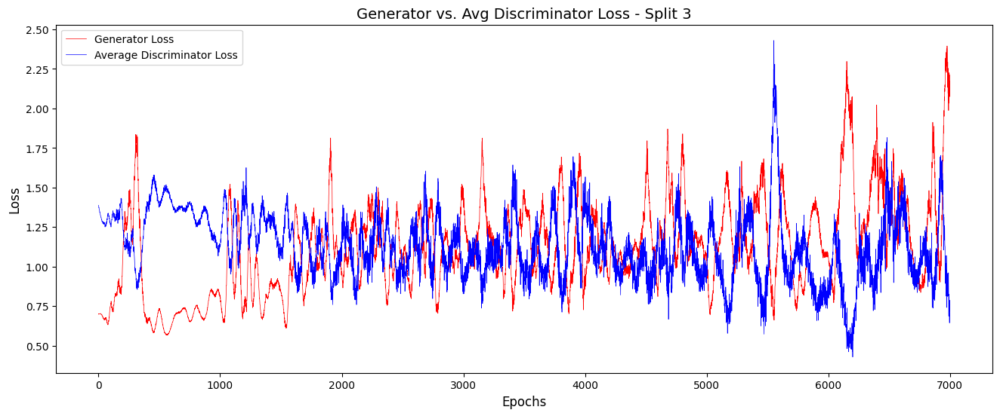

In [ ]:
# AVG LOSS ON 3 DIS

for split_idx, losses in split_losses.items():
    plt.figure(figsize=(16, 6))

    # AVG
    avg_discriminator_loss = [sum(epoch_losses) / len(epoch_losses) for epoch_losses in zip(*losses["discriminators"])]

    # gen loss
    plt.plot(losses["generator"], label='Generator Loss', color='red', linewidth=0.5, alpha=1)

    # avg dis loss
    plt.plot(avg_discriminator_loss, label='Average Discriminator Loss', color='blue', linewidth=0.5, alpha=1)

    plt.xlabel('Epochs', fontsize=12)
    plt.ylabel('Loss', fontsize=12)
    plt.title(f'Generator vs. Avg Discriminator Loss - Split {split_idx + 1}', fontsize=14)
    plt.legend(fontsize=10)
    plt.show()


b.	After training is complete, use your model to generate a synthetic dataset equal in size to your training set.

In [ ]:
# synthetic for each split
synthetic_datasets = []
for split_idx, (train_df, test_df, _, _) in enumerate(splits):
    print(f"Generating synthetic data for Split {split_idx + 1}...")

    z = torch.randn(len(train_df), z_dim).to(device)  # random noise in the size of the original data
    synthetic_data = generator(z).detach().cpu().numpy()  # create the fake
    synthetic_df = pd.DataFrame(synthetic_data, columns=train_df.columns)  # to tensor
    synthetic_datasets.append(synthetic_df)

Generating synthetic data for Split 1...
Generating synthetic data for Split 2...
Generating synthetic data for Split 3...


c.	Produce visualizations comparing real vs. synthetic feature

Visualizing feature distributions for split 1...


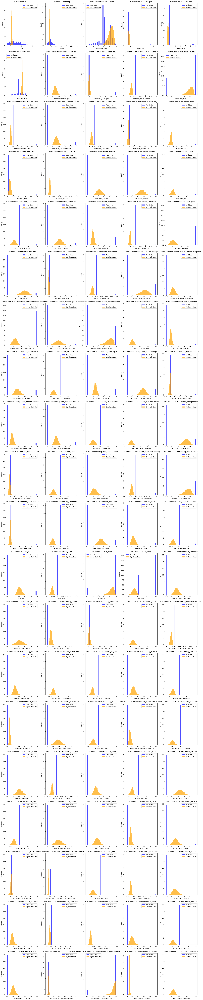

Visualizing box plots for split 1...


<ipython-input-34-d5f4a2ed33e3>:38: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-34-d5f4a2ed33e3>:38: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-34-d5f4a2ed33e3>:38: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-34-d5f4a2ed33e3>:38: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-34-d5f4a2ed33e3>:38: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick

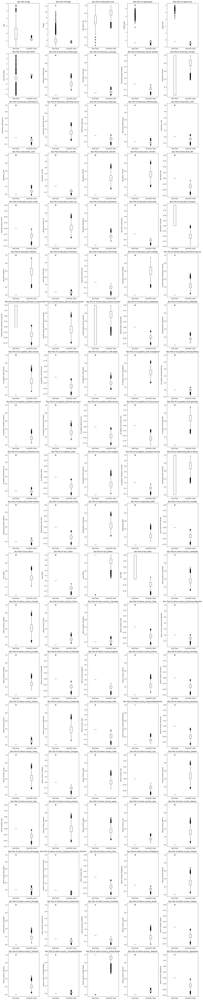

Visualizing feature distributions for split 2...


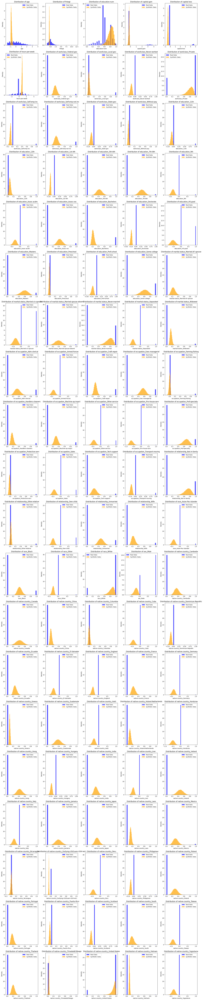

Visualizing box plots for split 2...


<ipython-input-34-d5f4a2ed33e3>:38: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-34-d5f4a2ed33e3>:38: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-34-d5f4a2ed33e3>:38: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-34-d5f4a2ed33e3>:38: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-34-d5f4a2ed33e3>:38: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick

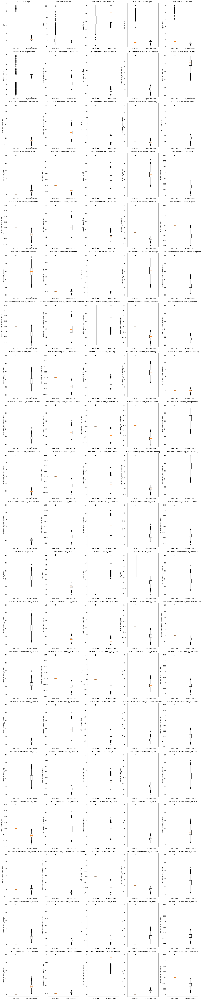

Visualizing feature distributions for split 3...


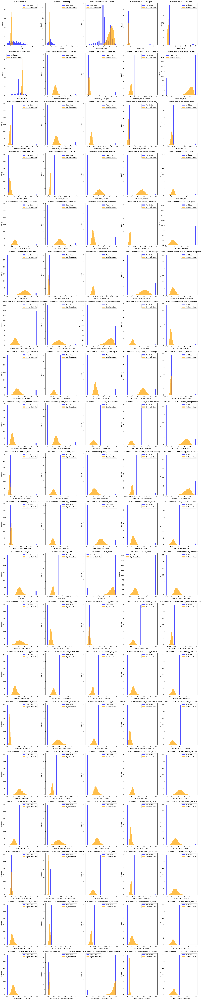

Visualizing box plots for split 3...


<ipython-input-34-d5f4a2ed33e3>:38: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-34-d5f4a2ed33e3>:38: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-34-d5f4a2ed33e3>:38: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-34-d5f4a2ed33e3>:38: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-34-d5f4a2ed33e3>:38: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick

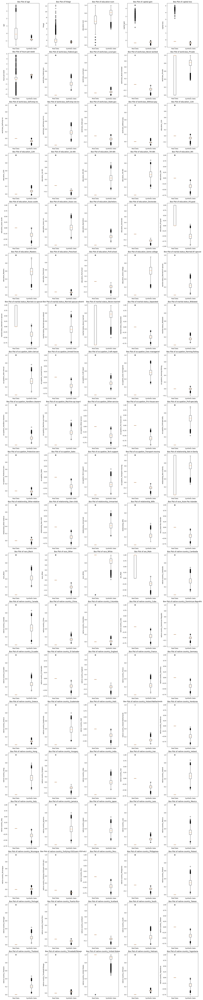

In [ ]:
n_cols = 5

for split_idx, (train_df, synthetic_df) in enumerate(zip([s[0] for s in splits], synthetic_datasets)):
    print(f"Visualizing feature distributions for split {split_idx + 1}...")

    # bool to num
    train_df = train_df.astype({col: int for col in train_df.select_dtypes(include=['bool']).columns})
    synthetic_df = synthetic_df.astype({col: int for col in synthetic_df.select_dtypes(include=['bool']).columns})

    # columns names
    all_columns = train_df.columns
    n_rows = int(np.ceil(len(all_columns) / n_cols))  # design stucture

    # create histogram
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 5 * n_rows))
    axes = axes.flatten()

    for i, col in enumerate(all_columns):
        ax = axes[i]
        ax.hist(train_df[col], bins=30, alpha=0.7, label='Real Data', color='blue', density=True)
        ax.hist(synthetic_df[col], bins=30, alpha=0.7, label='Synthetic Data', color='orange', density=True)
        ax.set_title(f'Distribution of {col}')
        ax.set_xlabel(col)
        ax.set_ylabel('Density')
        ax.legend()

    plt.tight_layout()
    plt.show()

    print(f"Visualizing box plots for split {split_idx + 1}...")

    # Boxplots
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 5 * n_rows))
    axes = axes.flatten()

    for i, col in enumerate(all_columns):
        ax = axes[i]
        ax.boxplot(
            [train_df[col].dropna(), synthetic_df[col].dropna()],
            labels=['Real Data', 'Synthetic Data']
        )
        ax.set_title(f'Box Plot of {col}')
        ax.set_ylabel(col)

    plt.tight_layout()
    plt.show()


d. *detection metric*

In [ ]:
overall_auc_scores = []
# AUC-ROC score
for split_idx, (train_df, synthetic_df) in enumerate(zip([s[0] for s in splits], synthetic_datasets)):
    print(f"Processing Split {split_idx + 1}...")

    # label the data
    real_data = train_df.copy()
    real_data['label'] = 0
    synthetic_data = synthetic_df.copy()
    synthetic_data['label'] = 1

    combined_data = pd.concat([real_data, synthetic_data], ignore_index=True)
    X = combined_data.drop(columns=['label'])
    y = combined_data['label']

    # Stratified K-Fold
    skf = StratifiedKFold(n_splits=4, shuffle=True, random_state=42)
    auc_scores = []

    # eval with 4-fold
    fold_splits = list(skf.split(X, y))
    for i in range(4):
        test_indices = fold_splits[i][1]
        train_indices = np.concatenate([fold_splits[j][1] for j in range(4) if j != i])

        # split to train -test
        X_train, X_test = X.iloc[train_indices], X.iloc[test_indices]
        y_train, y_test = y.iloc[train_indices], y.iloc[test_indices]

        # Random Forest training
        rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
        rf_model.fit(X_train, y_train)

        # prob pred
        y_pred_prob = rf_model.predict_proba(X_test)[:, 1]

        # AUC-ROC
        auc = roc_auc_score(y_test, y_pred_prob)
        auc_scores.append(auc)

    # AVG AUC for the split
    split_avg_auc = np.mean(auc_scores)
    overall_auc_scores.append(split_avg_auc)
    print(f"Average AUC for Split {split_idx + 1}: {split_avg_auc:.4f}")

overall_avg_auc = np.mean(overall_auc_scores)
print(f"\nOverall Average AUC across all splits: {overall_avg_auc:.4f}")


Processing Split 1...
Average AUC for Split 1: 1.0000
Processing Split 2...
Average AUC for Split 2: 1.0000
Processing Split 3...
Average AUC for Split 3: 1.0000

Overall Average AUC across all splits: 1.0000


e. *efficacy*

In [ ]:
efficacy_scores = []

# for each Splits
for split_idx, (split, synthetic_df) in enumerate(zip(splits, synthetic_datasets)):
    train_df, test_df, y_train, y_test = split
    print(f"Processing Split {split_idx + 1} for efficacy...")

    # random forest on the real data - task (i)
    rf_real = RandomForestClassifier(n_estimators=100, random_state=42)
    rf_real.fit(train_df, y_train)
    y_pred_prob_real = rf_real.predict_proba(test_df)[:, 1]
    auc_real = roc_auc_score(y_test, y_pred_prob_real)

    # random forest on the synthetic data and evaluate using test set - task (ii)
    rf_synthetic = RandomForestClassifier(n_estimators=100, random_state=42)
    rf_synthetic.fit(synthetic_df, y_train)
    y_pred_prob_synthetic = rf_synthetic.predict_proba(test_df)[:, 1]
    auc_synthetic = roc_auc_score(y_test, y_pred_prob_synthetic)

    # devide the AUCs - task (iii)
    efficacy_score = auc_synthetic / auc_real if auc_real > 0 else 0
    efficacy_scores.append(efficacy_score)

    # prints
    print(f"Split {split_idx + 1}:")
    print(f"  AUC (Real Data)     : {auc_real:.4f}")
    print(f"  AUC (Synthetic Data): {auc_synthetic:.4f}")
    print(f"  Efficacy Score      : {efficacy_score:.4f}")

# average on all splits
overall_efficacy = np.mean(efficacy_scores)
print(f"\nOverall Average Efficacy Score across all splits: {overall_efficacy:.4f}")


Processing Split 1 for efficacy...
Split 1:
  AUC (Real Data)     : 0.9089
  AUC (Synthetic Data): 0.6453
  Efficacy Score      : 0.7100
Processing Split 2 for efficacy...
Split 2:
  AUC (Real Data)     : 0.9026
  AUC (Synthetic Data): 0.6367
  Efficacy Score      : 0.7054
Processing Split 3 for efficacy...
Split 3:
  AUC (Real Data)     : 0.9066
  AUC (Synthetic Data): 0.3818
  Efficacy Score      : 0.4212

Overall Average Efficacy Score across all splits: 0.6122


### cGAN Architecture

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F

class cGenerator(nn.Module):
    def __init__(self, z_dim, data_dim, label_dim, hidden_dim=128):
        super(cGenerator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(z_dim + label_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim * 2),
            nn.ReLU(),
            nn.Linear(hidden_dim * 2, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, data_dim),
            nn.Tanh()
        )

    def forward(self, z, labels):
        # Concatenate noise and condition
        # z: (batch_size, z_dim), labels: (batch_size, label_dim)
        conditional_input = torch.cat([z, labels], dim=1)
        return self.model(conditional_input)


class cDiscriminator(nn.Module):
    def __init__(self, data_dim, label_dim, hidden_dim=128):
        super(cDiscriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(data_dim + label_dim, hidden_dim),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3),
            nn.Linear(hidden_dim, hidden_dim),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3),
            nn.Linear(hidden_dim, 1),
            nn.Sigmoid()
        )

    def forward(self, x, labels):
        # Concatenate data and its condition
        # x: (batch_size, data_dim), labels: (batch_size, label_dim)
        conditional_input = torch.cat([x, labels], dim=1)
        return self.model(conditional_input)


In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from tqdm import tqdm
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ------------------------------
# cGAN Training Code
# ------------------------------

# Hyperparameters
z_dim = 100         # Dimension of the noise vector.
hidden_dim = 128    # Number of neurons in the hidden layers.
lr = 0.0002         # Learning rate.
num_epochs = 7000
batch_size = 64

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Lists to store the trained models and losses for each split.
trained_models = []
losses_per_split = []

for split_idx, (train_df, test_df, y_train, y_test) in enumerate(splits):
    print(f"Starting training for cGAN split {split_idx + 1}...")

    # Ensure training data is in float format.
    train_df = train_df.astype(float)

    # --------------------------------------------------
    # Process Labels: Convert to One-Hot Encoding if Needed
    # --------------------------------------------------
    if isinstance(y_train, (pd.Series, pd.DataFrame)):
        y_train_one_hot = pd.get_dummies(y_train)
        y_train_arr = y_train_one_hot.values
    elif isinstance(y_train, np.ndarray):
        if y_train.ndim == 1 or y_train.shape[1] == 1:
            unique_labels = np.unique(y_train)
            label_dict = {label: idx for idx, label in enumerate(unique_labels)}
            one_hot = np.zeros((len(y_train), len(unique_labels)))
            for i, label in enumerate(y_train):
                one_hot[i, label_dict[label]] = 1
            y_train_arr = one_hot
        else:
            y_train_arr = y_train
    else:
        raise ValueError("Unsupported type for y_train")

    # Determine dimensions.
    label_dim = y_train_arr.shape[1]
    data_dim = train_df.shape[1]

    # ------------------------------
    # Create Models and Optimizers
    # ------------------------------
    generator = cGenerator(z_dim, data_dim, label_dim, hidden_dim).to(device)
    discriminator = cDiscriminator(data_dim, label_dim, hidden_dim).to(device)

    loss_function = nn.BCELoss()  # Binary Cross-Entropy Loss.

    optimizer_g = optim.Adam(generator.parameters(), lr=lr)
    optimizer_d = optim.Adam(discriminator.parameters(), lr=lr)

    num_samples = len(train_df)

    # Lists to store losses for each epoch.
    d_losses = []
    g_losses = []

    # ------------------------------
    # Training Loop
    # ------------------------------
    for epoch in tqdm(range(num_epochs), desc=f"Training Progress (cGAN Split {split_idx + 1})"):
        # --- Train Discriminator ---
        indices = np.random.randint(0, num_samples, batch_size)
        real_data = torch.tensor(train_df.iloc[indices].values, dtype=torch.float32).to(device)
        real_labels = torch.tensor(y_train_arr[indices], dtype=torch.float32).to(device)

        optimizer_d.zero_grad()
        real_outputs = discriminator(real_data, real_labels)
        real_targets = torch.ones(batch_size, 1).to(device)
        real_loss = loss_function(real_outputs, real_targets)

        z = torch.randn(batch_size, z_dim).to(device)
        fake_data = generator(z, real_labels)
        fake_outputs = discriminator(fake_data.detach(), real_labels)
        fake_targets = torch.zeros(batch_size, 1).to(device)
        fake_loss = loss_function(fake_outputs, fake_targets)

        d_loss = real_loss + fake_loss
        d_loss.backward()
        optimizer_d.step()

        # --- Train Generator ---
        optimizer_g.zero_grad()
        z = torch.randn(batch_size, z_dim).to(device)
        fake_data = generator(z, real_labels)
        fake_outputs = discriminator(fake_data, real_labels)
        g_loss = -torch.mean(torch.log(fake_outputs + 1e-8))
        g_loss.backward()
        optimizer_g.step()

        # Save losses for the current epoch.
        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())

    # Save losses and trained models for the current split.
    losses_per_split.append({"d_losses": d_losses, "g_losses": g_losses})
    trained_models.append({"generator": generator, "discriminator": discriminator, "test_df": test_df})

    print(f"Training for cGAN split {split_idx + 1} completed.\n\n")

print("cGAN Training complete for all splits.")





Starting training for cGAN split 1...


Training Progress (cGAN Split 1): 100%|██████████| 7000/7000 [01:18<00:00, 88.98it/s]


Training for cGAN split 1 completed.


Starting training for cGAN split 2...


Training Progress (cGAN Split 2): 100%|██████████| 7000/7000 [01:18<00:00, 88.79it/s]


Training for cGAN split 2 completed.


Starting training for cGAN split 3...


Training Progress (cGAN Split 3): 100%|██████████| 7000/7000 [01:19<00:00, 87.52it/s]

Training for cGAN split 3 completed.


cGAN Training complete for all splits.


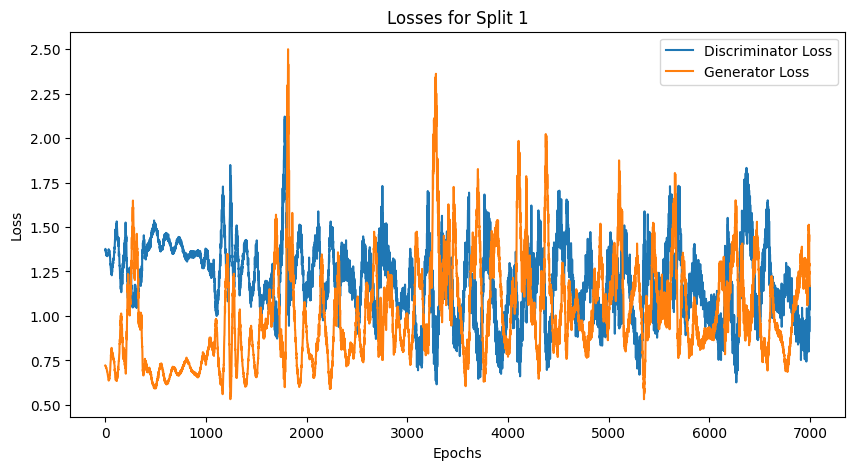

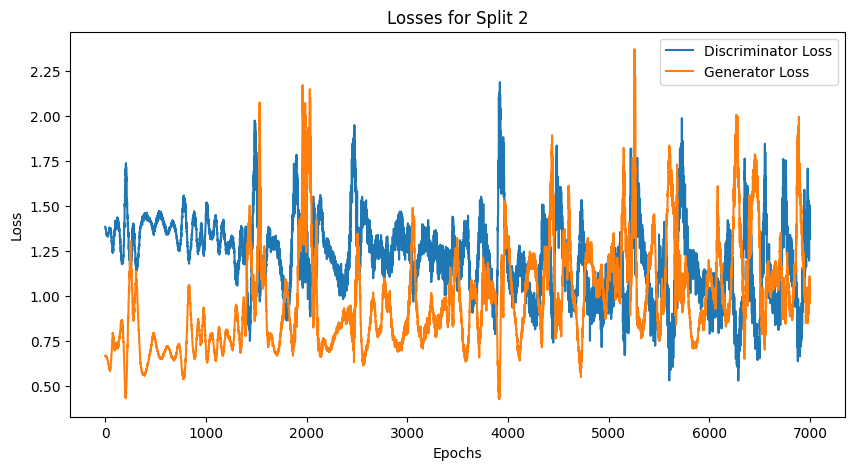

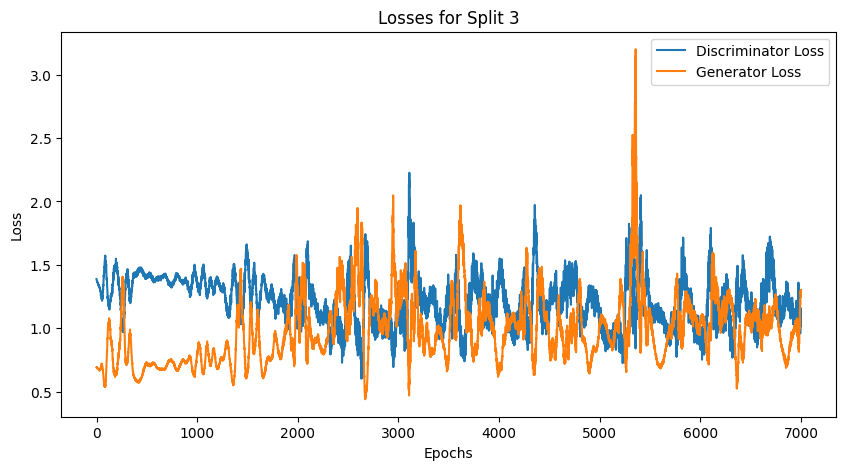

In [ ]:
# ------------------------------
# Plot Loss Graphs
# ------------------------------
for split_idx, losses in enumerate(losses_per_split):
    plt.figure(figsize=(10, 5))
    plt.plot(losses["d_losses"], label="Discriminator Loss")
    plt.plot(losses["g_losses"], label="Generator Loss")
    plt.title(f"Losses for Split {split_idx + 1}")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.legend()
    plt.show()

In [ ]:
import torch
import pandas as pd
import numpy as np

# List to store synthetic datasets generated for each split.
synthetic_datasets = []

for split_idx, model in enumerate(trained_models):
    print(f"Generating synthetic dataset for cGAN split {split_idx + 1} with maintained label ratios...")

    # Retrieve the cGAN generator from the trained model and set to eval mode.
    generator = model["generator"]
    generator.eval()

    # Retrieve training data and labels for the current split.
    train_df, _, y_train, _ = splits[split_idx]
    train_df = train_df.astype(float)
    data_dim = train_df.shape[1]

    # -------------------------------------------------------------------
    # Process the target labels (income) to obtain one-hot encoded labels.
    # -------------------------------------------------------------------
    # If y_train is a pandas Series or DataFrame, convert it to one-hot encoding.
    if isinstance(y_train, (pd.Series, pd.DataFrame)):
        # If y_train is a DataFrame, assume the target column is named "income"
        if isinstance(y_train, pd.DataFrame) and "income" in y_train.columns:
            y_target = y_train["income"]
        else:
            y_target = y_train

        # Use pd.get_dummies to one-hot encode and also preserve category names.
        y_train_one_hot = pd.get_dummies(y_target)
        y_train_arr = y_train_one_hot.values
        categories = y_train_one_hot.columns.tolist()
        # Compute counts for each income category.
        label_counts = y_target.value_counts().sort_index()
    elif isinstance(y_train, np.ndarray):
        # If using a numpy array and it is not already one-hot encoded, assume it is a 1D array.
        if y_train.ndim == 1 or y_train.shape[1] == 1:
            unique_labels = np.unique(y_train)
            label_counts = {label: (y_train == label).sum() for label in unique_labels}
            # Create one-hot encoded labels manually.
            categories = sorted(unique_labels)
            one_hot_list = []
            for label in y_train:
                one_hot = np.zeros(len(categories))
                one_hot[categories.index(label)] = 1
                one_hot_list.append(one_hot)
            y_train_arr = np.array(one_hot_list)
        else:
            y_train_arr = y_train
            # For simplicity, assume label_counts are computed using argmax.
            label_indices = np.argmax(y_train_arr, axis=1)
            unique, counts = np.unique(label_indices, return_counts=True)
            label_counts = dict(zip(unique, counts))
            categories = list(range(y_train_arr.shape[1]))
    else:
        raise ValueError("Unsupported type for y_train.")

    # -------------------------------------------------------------------
    # Generate synthetic samples for each income category using the counts.
    # -------------------------------------------------------------------
    synthetic_dfs = []  # to collect synthetic data for each label

    for cat in categories:
        # Determine the number of samples for this income category.
        # If y_target is a Series, then cat will be one of its values.
        if isinstance(label_counts, pd.Series):
            num_samples = int(label_counts.loc[cat])
        else:
            # For numpy arrays or dicts with numeric keys.
            num_samples = int(label_counts[cat])
        if num_samples == 0:
            continue  # Skip if no sample exists for this category.

        # Create a one-hot vector for the current category.
        one_hot_label = np.zeros((1, len(categories)))
        one_hot_label[0, categories.index(cat)] = 1
        # Repeat it for num_samples rows.
        one_hot_labels = np.repeat(one_hot_label, num_samples, axis=0)

        # Generate a noise vector for these samples.
        z = torch.randn(num_samples, z_dim).to(device)
        # Convert the one-hot labels to a torch tensor.
        labels_tensor = torch.tensor(one_hot_labels, dtype=torch.float32).to(device)

        # Generate synthetic data for the current category.
        with torch.no_grad():
            synthetic_data_cat = generator(z, labels_tensor).cpu().numpy()

        # Create a DataFrame for these synthetic samples.
        df_cat = pd.DataFrame(synthetic_data_cat, columns=train_df.columns)
        # Optionally, add the corresponding income label.
        df_cat["income"] = cat
        synthetic_dfs.append(df_cat)

    # Concatenate all the synthetic data frames so that the overall dataset
    # has the same income ratios as the original training set.
    synthetic_df = pd.concat(synthetic_dfs, axis=0).reset_index(drop=True)

    synthetic_datasets.append(synthetic_df)
    print(f"Synthetic dataset for cGAN split {split_idx + 1} generated successfully with maintained income ratios.\n")

print("All synthetic datasets generated with maintained label ratios for 'income'.")


Generating synthetic dataset for cGAN split 1 with maintained label ratios...
Synthetic dataset for cGAN split 1 generated successfully with maintained income ratios.

Generating synthetic dataset for cGAN split 2 with maintained label ratios...
Synthetic dataset for cGAN split 2 generated successfully with maintained income ratios.

Generating synthetic dataset for cGAN split 3 with maintained label ratios...
Synthetic dataset for cGAN split 3 generated successfully with maintained income ratios.

All synthetic datasets generated with maintained label ratios for 'income'.


In [ ]:
# Convert boolean columns to integers before plotting
train_df = train_df.astype({col: int for col in train_df.select_dtypes(include=['bool']).columns})
synthetic_df = synthetic_df.astype({col: int for col in synthetic_df.select_dtypes(include=['bool']).columns})


In [ ]:
'income' in synthetic_df.columns


True

Visualizing feature distributions for split 1...


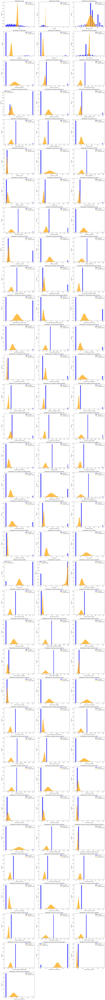

Visualizing feature distributions for split 2...


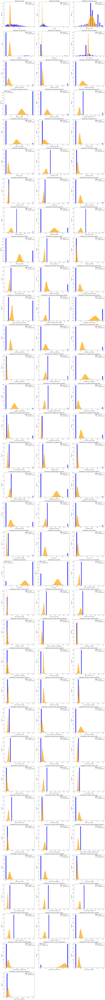

Visualizing feature distributions for split 3...


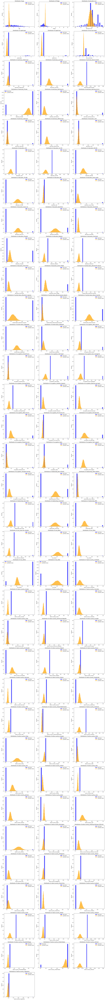

In [ ]:
for split_idx, (train_df, synthetic_df) in enumerate(zip([s[0] for s in splits], synthetic_datasets)):
    print(f"Visualizing feature distributions for split {split_idx + 1}...")

    # Convert boolean columns to integers
    train_df = train_df.astype({col: int for col in train_df.select_dtypes(include=['bool']).columns})
    synthetic_df = synthetic_df.astype({col: int for col in synthetic_df.select_dtypes(include=['bool']).columns})

    # Combine numerical and categorical columns
    all_columns = train_df.columns

    # Define Subplots
    n_cols = 3  # Number of columns in the grid
    n_rows = int(np.ceil(len(all_columns) / n_cols))  # Number of rows needed
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 5 * n_rows))
    axes = axes.flatten()  # Flatten the axes array for easy indexing

    for i, col in enumerate(all_columns):
        ax = axes[i]
        ax.hist(train_df[col], bins=30, alpha=0.7, label='Real Data', color='blue', density=True)
        ax.hist(synthetic_df[col], bins=30, alpha=0.7, label='Synthetic Data', color='orange', density=True)
        ax.set_title(f'Distribution of {col}')
        ax.set_xlabel(col)
        ax.set_ylabel('Density')
        ax.legend()

    # Hide unused subplots
    for j in range(len(all_columns), len(axes)):
        axes[j].set_visible(False)

    plt.tight_layout()
    plt.show()


Visualizing box plots for cGAN split 1...


<ipython-input-58-f6cabab1994d>:25: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-58-f6cabab1994d>:25: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-58-f6cabab1994d>:25: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-58-f6cabab1994d>:25: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-58-f6cabab1994d>:25: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick

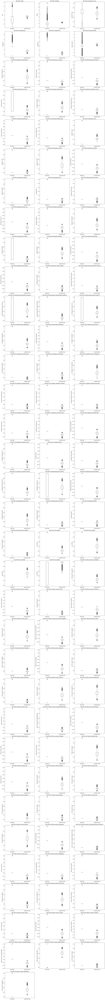

Visualizing box plots for cGAN split 2...


<ipython-input-58-f6cabab1994d>:25: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-58-f6cabab1994d>:25: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-58-f6cabab1994d>:25: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-58-f6cabab1994d>:25: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-58-f6cabab1994d>:25: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick

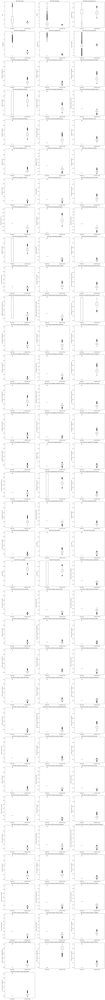

Visualizing box plots for cGAN split 3...


<ipython-input-58-f6cabab1994d>:25: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-58-f6cabab1994d>:25: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-58-f6cabab1994d>:25: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-58-f6cabab1994d>:25: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(
<ipython-input-58-f6cabab1994d>:25: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick

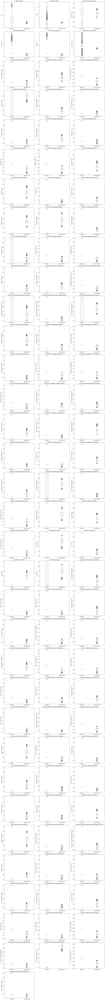

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Loop through each split and corresponding synthetic dataset
for split_idx, (split, synthetic_df) in enumerate(zip(splits, synthetic_datasets)):
    train_df, _, y_train, _ = split
    print(f"Visualizing box plots for cGAN split {split_idx + 1}...")

    # Convert boolean columns to integers for compatibility
    train_df = train_df.astype({col: int for col in train_df.select_dtypes(include=['bool']).columns})
    synthetic_df = synthetic_df.astype({col: int for col in synthetic_df.select_dtypes(include=['bool']).columns})

    # Get all columns (numerical and categorical) to visualize
    all_columns = train_df.columns

    # Define subplots
    n_cols = 3  # Number of columns in the plot grid
    n_rows = int(np.ceil(len(all_columns) / n_cols))  # Number of rows needed
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 5 * n_rows))
    axes = axes.flatten()  # Flatten the axes array for easy indexing

    # Plot box plots for each feature
    for i, col in enumerate(all_columns):
        ax = axes[i]
        ax.boxplot(
            [train_df[col].dropna(), synthetic_df[col].dropna()],
            labels=['Real Data', 'Synthetic Data']
        )
        ax.set_title(f'Box Plot of {col}')
        ax.set_ylabel(col)

    # Hide any unused subplots
    for j in range(len(all_columns), len(axes)):
        axes[j].set_visible(False)

    # Display the plots
    plt.tight_layout()
    plt.show()



Detection

In [ ]:
overall_auc_scores = []
# AUC-ROC score
for split_idx, (train_df, synthetic_df) in enumerate(zip([s[0] for s in splits], synthetic_datasets)):
    print(f"Processing Split {split_idx + 1}...")

    # label the data
    real_data = train_df.copy()
    real_data['label'] = 0
    synthetic_data = synthetic_df.copy()
    synthetic_data['label'] = 1

    combined_data = pd.concat([real_data, synthetic_data], ignore_index=True)
    X = combined_data.drop(columns=['label'])
    y = combined_data['label']

    # Stratified K-Fold
    skf = StratifiedKFold(n_splits=4, shuffle=True, random_state=42)
    auc_scores = []

    # eval with 4-fold
    fold_splits = list(skf.split(X, y))
    for i in range(4):
        test_indices = fold_splits[i][1]
        train_indices = np.concatenate([fold_splits[j][1] for j in range(4) if j != i])

        # split to train -test
        X_train, X_test = X.iloc[train_indices], X.iloc[test_indices]
        y_train, y_test = y.iloc[train_indices], y.iloc[test_indices]

        # Random Forest training
        rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
        rf_model.fit(X_train, y_train)

        # prob pred
        y_pred_prob = rf_model.predict_proba(X_test)[:, 1]

        # AUC-ROC
        auc = roc_auc_score(y_test, y_pred_prob)
        auc_scores.append(auc)

    # AVG AUC for the split
    split_avg_auc = np.mean(auc_scores)
    overall_auc_scores.append(split_avg_auc)
    print(f"Average AUC for Split {split_idx + 1}: {split_avg_auc:.4f}")

overall_avg_auc = np.mean(overall_auc_scores)
print(f"\nOverall Average AUC across all splits: {overall_avg_auc:.4f}")


Processing Split 1...
Average AUC for Split 1: 1.0000
Processing Split 2...
Average AUC for Split 2: 1.0000
Processing Split 3...
Average AUC for Split 3: 1.0000

Overall Average AUC across all splits: 1.0000


efficency


In [ ]:
import numpy as np
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_auc_score

# Initialize an empty list to store efficacy scores.
efficacy_scores = []

# Loop through each split and corresponding synthetic dataset.
for split_idx, (split, synthetic_df) in enumerate(zip(splits, synthetic_datasets)):
    train_df, test_df, y_train, y_test = split
    print(f"Processing Split {split_idx + 1} for efficacy...")

    # -------------------------
    # Task (i): Train on real data
    # -------------------------
    # Train a Random Forest classifier on the real training data.
    rf_real = RandomForestClassifier(n_estimators=100, random_state=42)
    rf_real.fit(train_df, y_train)

    # Predict probabilities for the test set.
    y_pred_prob_real = rf_real.predict_proba(test_df)[:, 1]

    # Calculate the AUC score for the real data.
    auc_real = roc_auc_score(y_test, y_pred_prob_real)

    # -------------------------
    # Task (ii): Train on synthetic data
    # -------------------------
    # Remove the target feature 'income' from the synthetic dataset (if present).
    if 'income' in synthetic_df.columns:
        synthetic_df = synthetic_df.drop(columns=['income'])

    # Train a Random Forest classifier on the synthetic data.
    rf_synthetic = RandomForestClassifier(n_estimators=100, random_state=42)
    rf_synthetic.fit(synthetic_df, y_train)

    # Predict probabilities for the test set.
    y_pred_prob_synthetic = rf_synthetic.predict_proba(test_df)[:, 1]

    # Calculate the AUC score for the synthetic data.
    auc_synthetic = roc_auc_score(y_test, y_pred_prob_synthetic)

    # -------------------------
    # Task (iii): Calculate efficacy score
    # -------------------------
    # Divide the synthetic AUC by the real AUC to compute the efficacy score.
    efficacy_score = auc_synthetic / auc_real if auc_real > 0 else 0
    efficacy_scores.append(efficacy_score)

    # -------------------------
    # Print results for this split
    # -------------------------
    print(f"Split {split_idx + 1}:")
    print(f"  AUC (Real Data)     : {auc_real:.4f}")
    print(f"  AUC (Synthetic Data): {auc_synthetic:.4f}")
    print(f"  Efficacy Score      : {efficacy_score:.4f}")

# -------------------------
# Calculate and print the overall efficacy score
# -------------------------
overall_efficacy = np.mean(efficacy_scores)
print(f"\nOverall Average Efficacy Score across all splits: {overall_efficacy:.4f}")


Processing Split 1 for efficacy...
Split 1:
  AUC (Real Data)     : 0.9089
  AUC (Synthetic Data): 0.5450
  Efficacy Score      : 0.5997
Processing Split 2 for efficacy...
Split 2:
  AUC (Real Data)     : 0.9026
  AUC (Synthetic Data): 0.6373
  Efficacy Score      : 0.7061
Processing Split 3 for efficacy...
Split 3:
  AUC (Real Data)     : 0.9066
  AUC (Synthetic Data): 0.3362
  Efficacy Score      : 0.3708

Overall Average Efficacy Score across all splits: 0.5589
